## Scenario Descriptions

### CAGE Challenge 2

Your firm has been contracted by Florin to trial your new autonomous defence agents. Florin have given your agent authority to defend the computer network at one of their manufacturing plants. The network, shown in Figure 1, contains a user network for staff, an enterprise network, and an operational network which contains the key manufacturing and logistics servers. The defence agent receives an alert feed from Florin’s existing monitoring systems. It can run detailed analyses on hosts, then remove malicious software if found. If an attacker is too well established on a host to be removed, the host can be restored from a clean backup. Finally, the defence agent can deceive attackers by creating decoy services.

The network owner has undertaken an evaluation of the factory systems and contracted your firm to defend these systems according to the following criteria:

Maintain the critical operational server to ensure information about the new weapon system is not revealed to Guilder and the production and delivery of the new weapon system remains on schedule.
Where possible, maintain enterprise servers to ensure day-to-day operations of the manufacturing plant are not disrupted or revealed.”

Subnet 1 consists of user hosts that are not critical. \
Subnet 2 consists of enterprise servers designed to support the user activities on Subnet 1. \
Subnet 3 contains the critical operational server and three user hosts.

<img src="https://github.com/cage-challenge/cage-challenge-2/raw/main/images/figure1.png">

The effect of each action on the state of a targeted host is summarized with the diagram.

<img src="https://github.com/cage-challenge/cage-challenge-2/raw/main/images/figure2.png" caption="State Diagram">

### Appendix - Action Sets

Blue Action Sets
    
| Action     | Purpose                                                                                                                                                                                                                                                 | Parameters                                                                    | Output                                 |
|:-----------|:--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|:------------------------------------------------------------------------------|:---------------------------------------|
| Monitor | Collection of information about flagged malicious activity on the system\. Corresponds to action ID 1: Scan in the OpenC2 specification[^3]\.                                                                                                           | None *\(Note: This action occurs automatically if another action is chosen\)* | Network connections and associated processes that are identified as malicious\. |
| Analyse | Collection of further information on a specific host to enable blue to better identify if red is present on the system\. Corresponds to action ID 30: Investigate in the OpenC2 specification\.                                                         | Hostname                                                                      | Information on files associated with recent alerts including signature and entropy\.  |
| DecoyApache, DecoyFemitter, DecoyHarakaSMPT, DecoySmss, DecoySSHD, DecoySvchost, DecoyTomcat | Setup of a decoy service (as specified by the action name) on a specified host\. Green agents do not access these services, so any access is a clear example of red activity\.                                                                                                            | Hostname                                                                | An alert if the red agent accesses the new service\. |
| Remove | Attempting to remove red from a host by destroying malicious processes, files and services\. This action attempts to stop all processes identified as malicious by the monitor action\. Corresponds to action ID 10: Stop in the OpenC2 specification\. | Hostname                                                                      | Success/Failure |
| Restore | Restoring a system to a known good state\. This has significant consequences for system availability\. This action punishes Blue by \-1\. Corresponds to action ID 23: Restore in the OpenC2 specification\.                                            | Hostname                                                                      | Success/Failure  |

Red Action Sets

| Action     | Purpose                                                                                                                                                    | Parameters       | Output                                 |
|:-----------|:-----------------------------------------------------------------------------------------------------------------------------------------------------------|:-----------------|:---------------------------------------|
| Discover Remote Systems | ATT&CK[^4] Technique T1018 Remote System Discovery\. Discovers new hosts/IP addresses in the network through active scanning using tools such as ping\.    | Subnet           | IP addresses in the chosen subnet from hosts that respond to ping |
| Discover Network Services | ATT&CK Technique T1046 Network Service Scanning. Discovers responsive services on a selected host by initiating a connection with that host\.              | Subnet           | Ports and service information |
| Exploit Network Services | ATT&CK Technique T1210 Exploitation of Remote Services\. This action attempts to exploit a specified service on a remote system\.                          | IP Address, Port | Success/Failure <br /> Initial recon of host if successful. |
| Escalate | ATT&CK Tactic TA0004 Privilege Escalation\. This action escalates the agent’s privilege on the host\.                                                      | Hostname         | Success/Failure <p> Internal information now available due to increased access to the host |
| Impact | ATT&CK Technique T1489 Service Stop\. This action disrupts the performance of the network and fulfils red’s objective of denying the operational service\. | Hostname         | Success/Failure  |

[^3]: Open Command and Control \(OpenC2\), [https://openc2\.org/](https://openc2\.org/)

[^4]: MITRE ATT&CK, [https://attack\.mitre\.org/](https://attack\.mitre\.org/)

### Agents

- Rules-based agents
- Deep Reinforcement Learning agents

### Rule-based agents

- Blue
    - RandomAgent: Takes a random action or a test action based on the epsilon value
    - BlueReactRemoveAgent: Adds suspicious hosts to the host list if the monitor finds something and then it will remove the program(session)
    - BlueReactRestoreAgent: Similar steps but restore the host from a cleaned backup.
- Red
    - RedMeanderAgent: Explores the network one subnet at a time, seeking to gain privileged access to all hosts in a subnet before moving on to the next one, eventually arriving at the Operational Server.
    - B_lineAgent: Attempts to move straight to the Operational Server using prior knowledge of the network layout.

In [1]:
# !pip list

In [1]:
import subprocess
import inspect
import time
import os
from statistics import mean, stdev
import random
import collections
from pprint import pprint

# import matplotlib.pyplot as plt
import networkx as nx
from networkx import connected_components
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd

from CybORG import CybORG, CYBORG_VERSION

from CybORG.Agents import B_lineAgent, BlueReactRestoreAgent, BlueReactRemoveAgent, \
    RandomAgent, RedMeanderAgent, SleepAgent
from CybORG.Agents.MainAgent import MainAgent

from CybORG.Agents.Wrappers.ChallengeWrapper import ChallengeWrapper
from CybORG.Agents.Wrappers.ChallengeWrapper2 import ChallengeWrapper2
from CybORG.Agents.Wrappers import EnumActionWrapper
from CybORG.Agents.Wrappers.FixedFlatWrapper import FixedFlatWrapper
from CybORG.Agents.Wrappers.IntListToAction import IntListToActionWrapper
from CybORG.Agents.Wrappers.OpenAIGymWrapper import OpenAIGymWrapper
from CybORG.Simulator.Scenarios.FileReaderScenarioGenerator import FileReaderScenarioGenerator

# from CybORG.Tutorial.Visualizers import GameStateManager, NetworkVisualizer
# from CybORG.Tutorial.Visualizers import MininetAdapter
# from CybORG.Tutorial.Mininet import Adapter
from Visualizers import GameStateManager, NetworkVisualizer
from Mininet import MininetAdapter

/home/ubuntu/justinyeh1995/CybORG/venv/lib/python3.10/site-packages/gym/wrappers/monitoring/video_recorder.py:9: DeprecationWarning: The distutils package is deprecated and slated for removal in Python 3.12. Use setuptools or check PEP 632 for potential alternatives
  import distutils.spawn
/home/ubuntu/justinyeh1995/CybORG/venv/lib/python3.10/site-packages/paramiko/transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


path is: /home/ubuntu/justinyeh1995/CybORG/CybORG/env.py


## Mininet Adapter

## Visualization

- input 
    - Observation from Red and Blue
    - Action for Blue / Red?
    - link_diagram

Mouse over event oberservations 
Different Shape
Different State

In [2]:
MAX_EPS = 1
agent_name = 'Blue'
random.seed(0)
cyborg_version = CYBORG_VERSION
scenario = 'Scenario2'

def wrap(env):
    # return ChallengeWrapper2(env=env, agent_name='Blue')
    return ChallengeWrapper(env=env, agent_name='Blue')

In [3]:
def main():
    cyborg_version = CYBORG_VERSION
    scenario = 'Scenario2'
    # commit_hash = get_git_revision_hash()
    commit_hash = "Not using git"
    # ask for a name
    name = "John Hannay"
    # ask for a team
    team = "CardiffUni"
    # ask for a name for the agent
    name_of_agent = "PPO + Greedy decoys"

    lines = inspect.getsource(wrap)
    wrap_line = lines.split('\n')[1].split('return ')[1]

    # Change this line to load your agent
    agent = MainAgent()
    
    print(f'Using agent {agent.__class__.__name__}, if this is incorrect please update the code to load in your agent')

    path = str(inspect.getfile(CybORG))
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario2.yaml'
    sg = FileReaderScenarioGenerator(path)

    print(f'using CybORG v{cyborg_version}, {scenario}\n')
    
    # game manager initialization
    game_state_manager = GameStateManager()
    
    for num_steps in [30]:
        for red_agent in [B_lineAgent]:
            red_agent = red_agent()
            cyborg = CybORG(sg, 'sim', agents={'Red': red_agent})
            wrapped_cyborg = wrap(cyborg)

            observation = wrapped_cyborg.reset()
            # observation = cyborg.reset().observation

            # set up game_state_manager
            game_state_manager.set_environment(cyborg=cyborg,
                                               red_agent=red_agent,
                                               blue_agent=agent,
                                               num_steps=num_steps)
            
            action_space = wrapped_cyborg.get_action_space(agent_name)
            # action_space = cyborg.get_action_space(agent_name)
            total_reward = []
            actions = []
            for i in range(MAX_EPS):
                r = []
                a = []
                
                # cyborg.env.env.tracker.render()
                for j in range(num_steps):
                    action = agent.get_action(observation, action_space)
                    observation, rew, done, info = wrapped_cyborg.step(action)
                    # result = cyborg.step(agent_name, action)
                    r.append(rew)
                    # r.append(result.reward)
                    a.append((str(cyborg.get_last_action('Blue')), str(cyborg.get_last_action('Red'))))
                    
                    # create state for this step
                    state_snapshot = game_state_manager.create_state_snapshot()
                    # game manager store state
                    game_state_manager.store_state(state_snapshot, i, j)
                # game manager reset
                agent.end_episode()
                total_reward.append(sum(r))
                actions.append(a)
                # observation = cyborg.reset().observation
                observation = wrapped_cyborg.reset()
                game_state_manager.reset()
    return game_state_manager.get_game_state()

In [4]:
def main_simple_agent():
    cyborg_version = CYBORG_VERSION
    scenario = 'Scenario2'
    # commit_hash = get_git_revision_hash()
    commit_hash = "Not using git"
    # ask for a name
    name = "John Hannay"
    # ask for a team
    team = "CardiffUni"
    # ask for a name for the agent
    name_of_agent = "PPO + Greedy decoys"

    lines = inspect.getsource(wrap)
    wrap_line = lines.split('\n')[1].split('return ')[1]

    # Change this line to load your agent
    agent = MainAgent()
    agent = BlueReactRemoveAgent()
    
    print(f'Using agent {agent.__class__.__name__}, if this is incorrect please update the code to load in your agent')

    path = str(inspect.getfile(CybORG))
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario2.yaml'
    sg = FileReaderScenarioGenerator(path)

    print(f'using CybORG v{cyborg_version}, {scenario}\n')
    
    # game manager initialization
    game_state_manager = GameStateManager()
    # mininet adapter initialization
    mininet_adapter = MininetAdapter()

    
    for num_steps in [30]:
        for red_agent in [B_lineAgent]:
            red_agent = red_agent()
            cyborg = CybORG(sg, 'sim', agents={'Red': red_agent})

            observation = cyborg.reset()
            # pprint(cyborg.get_ip_map())
            # pprint(cyborg.get_cidr_map())
            # pprint(cyborg.environment_controller.state.link_diagram.edges)
            # set up game_state_manager
            game_state_manager.set_environment(cyborg=cyborg,
                                               red_agent=red_agent,
                                               blue_agent=agent,
                                               num_steps=num_steps)
            game_state_manager.reset()


            # mininet adapter reset
            mininet_adapter.set_environment(cyborg=cyborg)
            mininet_adapter.reset()
            mininet_adapter.create_mininet_topo()
            
            action_space = cyborg.get_action_space(agent_name)

            total_reward = []
            actions = []
            for i in range(MAX_EPS):
                r = []
                a = []
                
                # cyborg.env.env.tracker.render()
                for j in range(num_steps):
                    blue_action_space = cyborg.get_action_space('Blue')
                    blue_obs = cyborg.get_observation('Blue') # get the newest observation
                    blue_action = agent.get_action(blue_obs, blue_action_space)
                                        
                    result = cyborg.step('Blue', blue_action, skip_valid_action_check=False)
                    pprint(cyborg.get_rewards())
                    
                    # create state for this step
                    state_snapshot = game_state_manager.create_state_snapshot()
                    pprint(game_state_manager.get_rewards())
                    # game manager store state
                    game_state_manager.store_state(state_snapshot, i, j)

                    
                # game manager reset
                agent.end_episode()
                total_reward.append(sum(r))
                actions.append(a)
                # observation = cyborg.reset().observation
                observation = cyborg.reset()
                game_state_manager.reset()
                # mininet adapter reset
                mininet_adapter.reset()
                mininet_adapter.create_mininet_topo()
        
        mininet_adapter.reset()

    return game_state_manager.get_game_state()

In [5]:
# %%capture
game_state_simple = main_simple_agent()
# game_state_pretained = main()

Using agent BlueReactRemoveAgent, if this is incorrect please update the code to load in your agent
using CybORG v3.1, Scenario2

env is: sim


/home/ubuntu/justinyeh1995/CybORG/venv/lib/python3.10/site-packages/gym/utils/seeding.py:47: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  deprecation(


Agent Interfaces are: {'Blue': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f19558d3970>, 'Green': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955703760>, 'Red': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955700b50>}
Cleaned up the topology
YAML file 'network_topology.yaml' created.
Mininet Topology Created Successfully:
mininet> 
====Perform a step====
The action to be performed is: {'Blue': Monitor}
In SimulationController script
In shared EnvironmentController script
Agent interface: {'Blue': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f19558d3970>, 'Green': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955703760>, 'Red': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955700b50>}
action is: {'Blue': Monitor, 'Green': Sleep, 'Red': DiscoverRemoteSystems 10.0.12.112/28}
--> in actions
In simcontroller execute action
action is: Monitor its type is: <class 'CybORG.Simulator.Actions.AbstractActions.Mon

/home/ubuntu/justinyeh1995/CybORG/venv/lib/python3.10/site-packages/gym/utils/seeding.py:47: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  deprecation(


{'Blue': {'HybridAvailabilityConfidentiality': 0.0, 'action_cost': 0.0},
 'Red': {'HybridImpactPwn': 0.0, 'action_cost': 0.0}}
====Perform a step====
The action to be performed is: {'Blue': Monitor}
In SimulationController script
In shared EnvironmentController script
Agent interface: {'Blue': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f19558d3970>, 'Green': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955703760>, 'Red': <CybORG.Shared.AgentInterface.AgentInterface object at 0x7f1955700b50>}
action is: {'Blue': Monitor, 'Green': Sleep, 'Red': ExploitRemoteService 10.0.12.125}
--> in actions
In simcontroller execute action
action is: Monitor its type is: <class 'CybORG.Simulator.Actions.AbstractActions.Monitor.Monitor'>
--> in actions
In simcontroller execute action
action is: ExploitRemoteService 10.0.12.125 its type is: <class 'CybORG.Simulator.Actions.AbstractActions.ExploitRemoteService.ExploitRemoteService'>
--> in end turn actions
In simcontroller exe

In [6]:
# game_state_simple

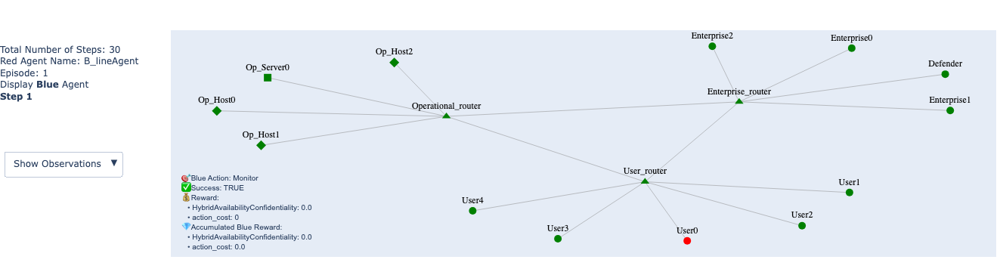

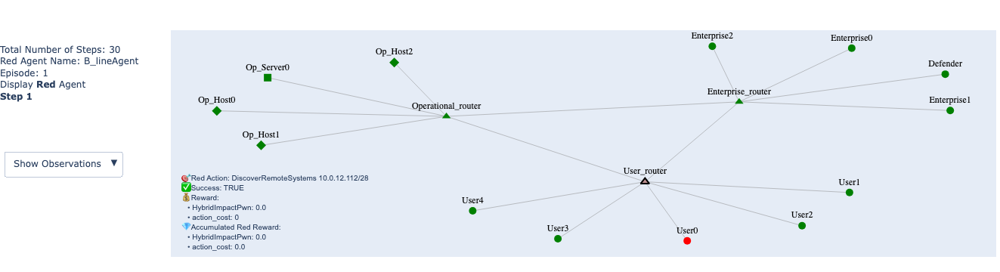

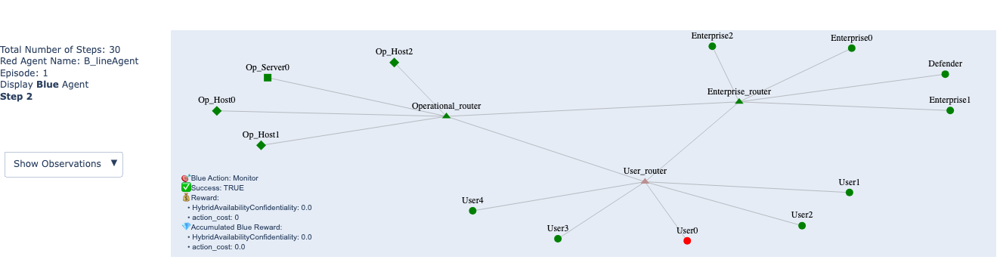

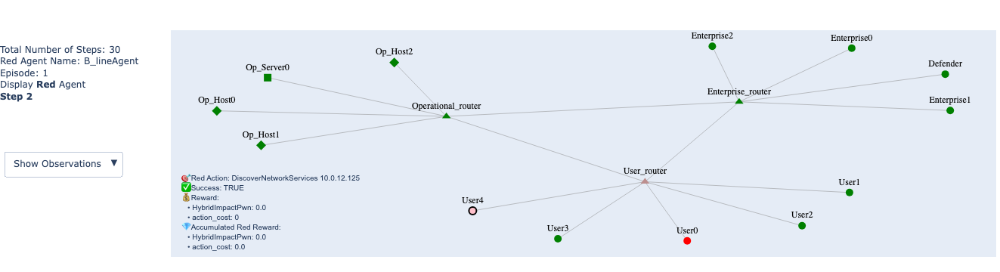

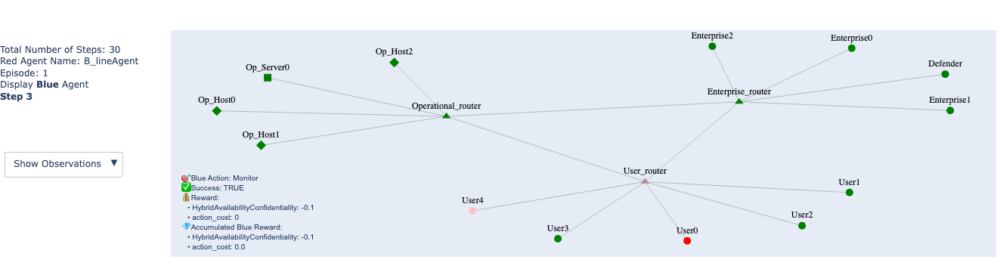

...

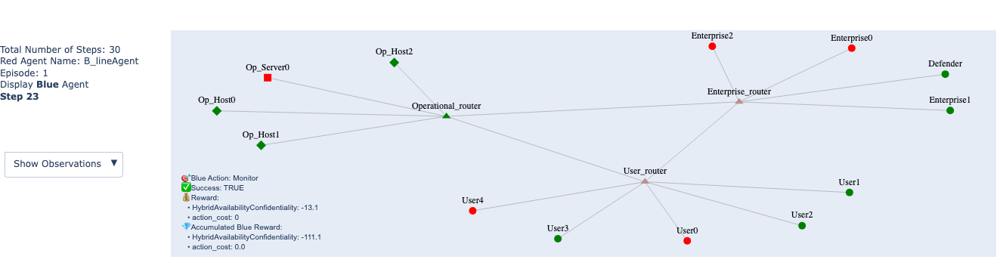

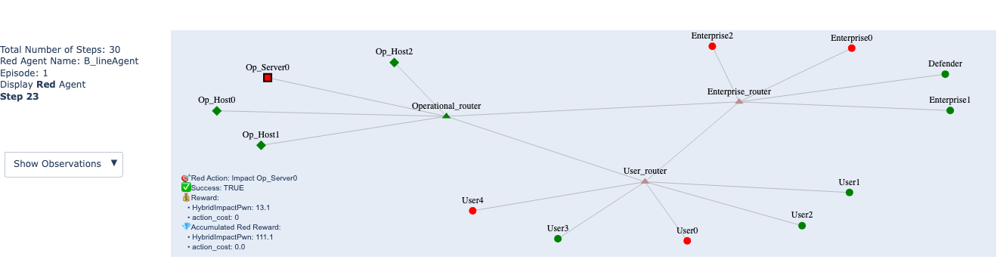

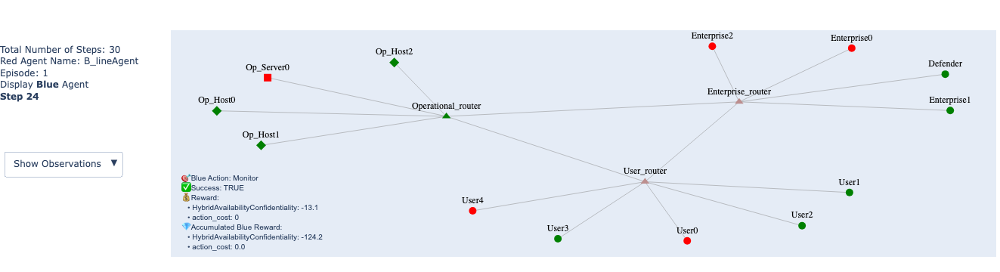

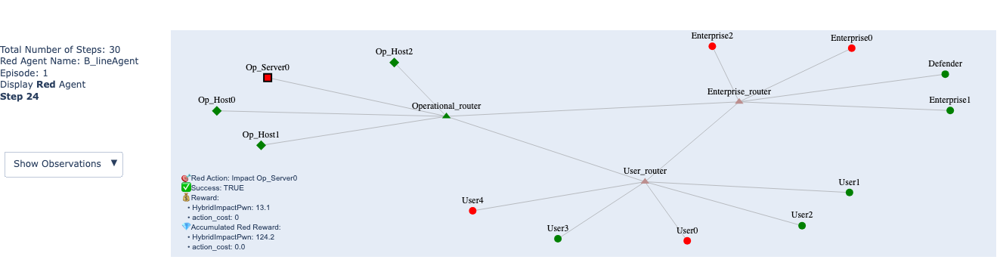

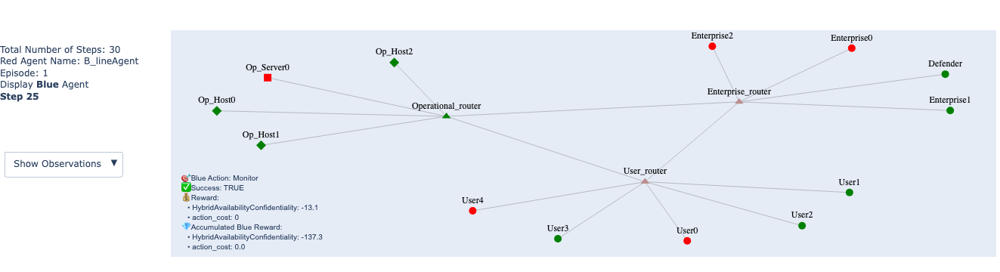

In [6]:
nv = NetworkVisualizer(game_state_simple)
nv.plot(save=False)

In [8]:
# nv.set_game_state(game_state_pretained)
# nv.plot(save=False)

In [140]:
def get_node_color(node, discovered_subnets=None, discovered_systems=None, exploited_hosts=None, escalated_hosts=None):
    color = "green"
    
    if 'router' in node:
        if node in discovered_subnets:
            color = 'rosybrown'
    
    if node in discovered_systems:
        color = "lightgreen"
    
    if node in escalated_hosts:
        color = "red"
        
    elif node in exploited_hosts:
        color = "orange"
    
    return color

def get_node_border(node, target_host=None, reset_host=None):
    if node in target_host:
        border = dict(width=2, color='#99004C')
    elif node in reset_host:
        border = dict(width=2, color='blue')
    else:
        border = dict(width=0, color='white')
    return border

In [139]:
def parse_action(cyborg, action_str, agent, host_map, ip_map):
    action_type = action_str.split(" ")[0]
    target_host = ""
    if cyborg.get_observation(agent)['success'].__str__() == 'TRUE':
        target_host = action_str.split(" ")[-1]
        # Update target host if it's an IP address to get the hostname
        target_host = ip_map.get(target_host, target_host)
    return target_host, action_type

def update_host_status(cyborg, red_action_str, blue_action_str, host_map, ip_map):
    target_host, discovered_subnet, discovered_system, exploited_host, escalated_host = None, None, None, None, None
    reset_host, remove_host, restore_host = None, None, None
    
    # Check Red's actions
    target_host, action_type = parse_action(cyborg, red_action_str, 'Red', host_map, ip_map)
    
    if target_host:
        if 'ExploitRemote' in action_type:
            exploited_host = target_host
        elif 'Privilege' in action_type or 'Impact' in action_type:
            escalated_host = target_host
        elif 'DiscoverRemoteSystems' in action_type:
            _cidr = ".".join(target_host.split(".")[:3])
            for ip in ip_map:
                if _cidr in ip and 'router' in ip_map[ip]:
                    discovered_subnet = ip_map[ip]
                    target_host = discovered_subnet
        elif 'DiscoverNetworkServices' in action_type:
            discovered_system = target_host
            
    # Check Blue's actions
    reset_host, action_type = parse_action(cyborg, blue_action_str, 'Blue', host_map, ip_map)
    if reset_host:
        if 'Remove' in action_type:
            remove_host = reset_host
        elif 'Restore' in action_type:
            restore_host = reset_host

    return target_host, reset_host, discovered_subnet, discovered_system, exploited_host, escalated_host, remove_host, restore_host
    

In [8]:
def run_pretrained_agent():

    lines = inspect.getsource(wrap)
    wrap_line = lines.split('\n')[1].split('return ')[1]

    # Change this line to load your agent
    agent = MainAgent()

    print(f'Using agent {agent.__class__.__name__}, if this is incorrect please update the code to load in your agent')

    # CC2
    path = str(inspect.getfile(CybORG))
    # path = path[:-7] + f'/Simulator/Scenarios/scenario_files/ScenarioDemo.yaml'
    # path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario_5nodes_randomgame.yaml'
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario2.yaml'
    sg = FileReaderScenarioGenerator(path)

    print(f'using CybORG v{cyborg_version}, {scenario}\n')
    for num_steps in [30]:
        agent_game_states = {}
        for red_agent in [B_lineAgent, RedMeanderAgent, SleepAgent]:

            red_agent = red_agent()
            cyborg = CybORG(sg, 'sim', agents={'Red': red_agent})
            
            wrapped_cyborg = wrap(cyborg)
            
            observation = wrapped_cyborg.reset()

            ip_map = dict(map(lambda item: (str(item[0]), item[1]), cyborg.environment_controller.state.ip_addresses.items()))
            host_map = { host:str(ip) for ip, host in ip_map.items()}

            action_space = wrapped_cyborg.get_action_space(agent_name)

            ############
            ## fo viz ##
            ############
            game_states = {}
            compromised_hosts = set()
            exploited_hosts = set()
            escalated_hosts = set()
            discovered_subnets = set()
            discovered_systems = set()
            # cyborg.env.env.tracker.render()
            for j in range(num_steps):
                action = agent.get_action(observation, action_space)
                observation, rew, done, info = wrapped_cyborg.step(action)

                ############
                ## fo viz ##
                ############
                link_diagram = cyborg.environment_controller.state.link_diagram
                red_action_str = cyborg.get_last_action('Red').__str__()
                blue_action_str = cyborg.get_last_action('Blue').__str__()
                
                (
                    target_host,
                    reset_host,
                    discovered_subnet, 
                    discovered_system,
                    exploited_host,
                    escalated_host,
                    remove_host,
                    restore_host
                ) = update_host_status(
                    cyborg,
                    red_action_str,
                    blue_action_str,
                    host_map,
                    ip_map
                )

                # if target_host:
                #     compromised_hosts.add(target_host)
        
                # if reset_host:
                #     compromised_hosts.discard(reset_host)
    
                if discovered_subnet:
                    discovered_subnets.add(discovered_subnet)
    
                if discovered_system:
                    discovered_systems.add(discovered_system)
                
                if exploited_host:
                    exploited_hosts.add(exploited_host)
                    compromised_hosts.add(exploited_host)
                if remove_host or restore_host:
                    exploited_hosts.discard(remove_host)
                    compromised_hosts.discard(remove_host)
                if escalated_host:
                    escalated_hosts.add(escalated_host)
                    compromised_hosts.add(escalated_host)
                if restore_host:
                    escalated_hosts.discard(restore_host)
                    compromised_hosts.discard(restore_host)
    
                print(compromised_hosts)
                
                agent_actions = {
                    "Red": {"action": red_action_str, "success": cyborg.get_observation('Red')['success'].__str__()},
                    "Blue": {"action": blue_action_str, "success": cyborg.get_observation('Blue')['success'].__str__()}
                }
        
                node_colors = [get_node_color(node, 
                                              discovered_subnets=discovered_subnets,
                                              discovered_systems=discovered_systems,
                                              exploited_hosts=exploited_hosts, 
                                              escalated_hosts=escalated_hosts) 
                               for node in link_diagram.nodes]
                
                node_borders = [get_node_border(node, 
                                                target_host=target_host, 
                                                reset_host=reset_host) 
                                for node in link_diagram.nodes]
                state_snapshot = {
                    'link_diagram': link_diagram.copy(),  # Assuming link_diagram is a NetworkX graph
                    'node_colors': node_colors.copy(),
                    'node_borders': node_borders.copy(),
                    'compromised_hosts': compromised_hosts.copy(),
                    # 'exploited_hosts': exploited_hosts.copy(),
                    # 'escalated_hosts': escalated_hosts.copy(),
                    'agent_actions': agent_actions.copy(),
                    'ip_map': ip_map.copy(),
                    'host_map': host_map.copy(),
                }
        
                # Store the snapshot in game_states
                game_states[j] = state_snapshot
            
            agent.end_episode()
            observation = wrapped_cyborg.reset()
              
            agent_game_states[red_agent.__class__.__name__] = game_states.copy()

    return agent_game_states


    

In [9]:
def run_episode_cc2(agent):
    # CC2
    path = str(inspect.getfile(CybORG))
    # path = path[:-7] + f'/Simulator/Scenarios/scenario_files/ScenarioDemo.yaml'
    # path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario_5nodes_randomgame.yaml'
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario2.yaml'
    sg = FileReaderScenarioGenerator(path)
    
    agent_game_states = {}
    for red_agent in [B_lineAgent, RedMeanderAgent, SleepAgent]:
        red_agent = red_agent()
        cyborg = CybORG(sg, 'sim', agents={'Red': red_agent})
        cyborg.reset()
        
        ip_map = dict(map(lambda item: (str(item[0]), item[1]), cyborg.environment_controller.state.ip_addresses.items()))
        host_map = { host:str(ip) for ip, host in ip_map.items()}
        ############
        ## fo viz ##
        ############
        game_states = {}
        compromised_hosts = set()
        exploited_hosts = set()
        escalated_hosts = set()
        discovered_subnets = set()
        discovered_systems = set()
        for i in range(100):
            # Blue
            blue_action_space = cyborg.get_action_space('Blue')
            blue_obs = cyborg.get_observation('Blue') # get the newest observation
            blue_action = agent.get_action(blue_obs, blue_action_space)
            
            # take a step
            results = cyborg.step('Blue', blue_action, skip_valid_action_check=False)
    
            ############
            ## fo viz ##
            ############
            link_diagram = cyborg.environment_controller.state.link_diagram
            red_action_str = cyborg.get_last_action('Red').__str__()
            blue_action_str = cyborg.get_last_action('Blue').__str__()
            
            (
                target_host,
                reset_host,
                discovered_subnet, 
                discovered_system,
                exploited_host,
                escalated_host,
                remove_host,
                restore_host
            ) = update_host_status(
                cyborg,
                red_action_str,
                blue_action_str,
                host_map,
                ip_map
            )       

            # if target_host:
            #     compromised_hosts.add(target_host)
    
            # if reset_host:
            #     compromised_hosts.discard(reset_host)

            if discovered_subnet:
                discovered_subnets.add(discovered_subnet)

            if discovered_system:
                discovered_systems.add(discovered_system)
            
            if exploited_host:
                exploited_hosts.add(exploited_host)
                compromised_hosts.add(exploited_host)
            if remove_host or restore_host:
                exploited_hosts.discard(remove_host)
                compromised_hosts.discard(remove_host)
            if escalated_host:
                escalated_hosts.add(escalated_host)
                compromised_hosts.add(escalated_host)
            if restore_host:
                escalated_hosts.discard(restore_host)
                compromised_hosts.discard(restore_host)

            print(compromised_hosts)
            
            agent_actions = {
                "Red": {"action": red_action_str, "success": cyborg.get_observation('Red')['success'].__str__()},
                "Blue": {"action": blue_action_str, "success": cyborg.get_observation('Blue')['success'].__str__()}
            }
    
            node_colors = [get_node_color(node, 
                                          discovered_subnets=discovered_subnets,
                                          discovered_systems=discovered_systems,
                                          exploited_hosts=exploited_hosts, 
                                          escalated_hosts=escalated_hosts) 
                           for node in link_diagram.nodes]
            
            node_borders = [get_node_border(node, 
                                            target_host=target_host, 
                                            reset_host=reset_host) 
                            for node in link_diagram.nodes]
 
            state_snapshot = {
                'link_diagram': link_diagram.copy(),  # Assuming link_diagram is a NetworkX graph
                'node_colors': node_colors.copy(),
                'node_borders': node_borders.copy(),
                'compromised_hosts': compromised_hosts.copy(),
                'exploited_hosts': exploited_hosts.copy(),
                'escalated_hosts': escalated_hosts.copy(),
                'agent_actions': agent_actions.copy(),
                'ip_map': ip_map.copy(),
                'host_map': host_map.copy(),
            }
    
            # Store the snapshot in game_states
            game_states[i] = state_snapshot
        
        agent.end_episode()
        observation = cyborg.reset().observation
        observation = cyborg.reset()
          
        agent_game_states[red_agent.__class__.__name__] = game_states.copy()

    return agent_game_states
    

In [10]:
def get_node_type(node):
    type = ""
    if 'router' in node:
        type = 'router'
    elif 'Op' in node:
        if 'Host' in node:
            type = 'op_host'
        else:
            type = 'op_server'
    elif 'Server' in node:
        type = 'server' 
    else:
        type = 'host'
    return type
         
                         
def interactive_plot(agent_game_states):
    for red_agent in agent_game_states:
        game_states = agent_game_states[red_agent]
        for step, state in game_states.items():
            link_diagram = state['link_diagram']
            compromised_hosts = state['compromised_hosts']
            node_colors = state['node_colors']
            node_borders = state['node_borders']
            agent_actions = state['agent_actions']
            # ip_map = state['ip_map']
            host_map = state['host_map']
            # Define a mapping of node types to Plotly symbols
            type_to_symbol = {
                'router': 'triangle-up',  # Triangle
                'server': 'square',  # Square
                'host': 'circle',          # Circle
                'op_host': 'diamond',
                'op_server': 'square'
            }
        
            # 'link_diagram' is the NetworkX graph
            pos = nx.spring_layout(link_diagram, seed=3113794652)
            
            edge_x = []
            edge_y = []
            for edge in link_diagram.edges():
                x0, y0 = pos[edge[0]]
                x1, y1 = pos[edge[1]]
                edge_x.extend([x0, x1, None])
                edge_y.extend([y0, y1, None])
            
            edge_trace = go.Scatter(
                x=edge_x, y=edge_y,
                line=dict(width=0.5, color='#888'),
                hoverinfo='none',
                mode='lines')
                
            # Prepare hover text and symbols for each node
            hover_text = []
            node_symbols = []
            node_x = []    
            node_y = []     
            node_names = []

            for i, node in enumerate(link_diagram.nodes()):
                x, y = pos[node]
                node_x.append(x)
                node_y.append(y)
                # Determine the status ...
                compromised = 'Yes' if node in compromised_hosts else 'No'
                node_names.append(node)
                hover_text.append(f"Node: {node}<br>IP Address: {host_map[node]}<br>Compromised: {compromised}")
                # Determine the type of the node and assign the corresponding symbol
                node_type = get_node_type(node)  # Replace this with your method to get node type
                node_symbols.append(type_to_symbol.get(node_type, 'circle'))  # Default to 'circle'
            
            # Create node trace
            node_trace = go.Scatter(
                x=node_x, y=node_y,
                mode='markers+text',
                hoverinfo='text',
                hovertext=hover_text,
                text=node_names,
                marker=dict(showscale=False, 
                            colorscale='Viridis', 
                            color=node_colors, 
                            line=dict(
                                color=[border['color'] for border in node_borders],  # List of colors for each marker
                                width=[border['width'] for border in node_borders],  # List of widths for each marker
                            ),
                            size=10, 
                            symbol=node_symbols
                           ),
                textposition="top center",  # Position the text above the markers
                textfont=dict(
                    family="sans serif",
                    size=12,
                    color="black")
            )
            
            # Your existing code to create the figure and layout
            fig = go.Figure(data=[edge_trace, node_trace],
                     layout=go.Layout(
                        title=f'<br>Red Agent Name: {red_agent}<br>Step {step+1}',
                        title_x=0.0,  # Centers the title
                        title_y=1.0,
                        titlefont_size=16,
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=20,l=5,r=5,t=40),
                        xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                        yaxis=dict(showgrid=False, zeroline=False, showticklabels=False)
                    ))
    
    
            # Create annotations for agent actions, initially invisible
            observations_annotations = []
            vertical_padding = 0.18
            for idx, (agent, action_info) in enumerate(state['agent_actions'].items()):
                observations_annotations.append(dict(
                    xref='paper', yref='paper',
                    x=0.01, y= 0.2 - idx * vertical_padding,  # Adjust these positions as needed
                    text=f"{agent}: <br>{action_info['action']} <br>Success: {action_info['success']}",
                    showarrow=False,
                    visible=True,  # Initially not visible
                    align="left"  # Ensure text is aligned for both agents
                ))
    
            # Add a button to toggle the visibility of observation annotations
            fig.update_layout(
                width=1000,
                annotations=observations_annotations,  # Include the annotations by default
                updatemenus=[
                    dict(
                        buttons=list([
                            dict(label="Show Observations",
                                 method="update",
                                 args=[{"visible": [True, True, True, True]},  # Set the visibility as required
                                       {"annotations": observations_annotations}]),
                            dict(label="Hide Observations",
                                 method="update",
                                 args=[{"visible": [True, True, True, False]},  # Reset to original visibility
                                       {"annotations": []}])
                        ]),
                        direction="down",
                        pad={"r": 10, "t": 10},
                        showactive=True,
                        # x=1.05,
                        # xanchor="left",
                        # y=1.05,
                        # yanchor="top"
                    )
                ]
            )
            # current_width = fig.layout.width
            # current_height = fig.layout.height
            
            # print(f"Current width: {current_width}")
            # print(f"Current height: {current_height}")

            if not os.path.exists("images"):
                os.mkdir("images")

            if not os.path.exists(f"images/{red_agent}"):
                os.mkdir(f"images/{red_agent}")

            fig.write_image(f"images/{red_agent}/step{step+1}.png")
                    
            fig.show()

In [8]:
# animation

# router blink
# surrond any change icon with dashlines(happnening this steps)

### Example 1: Blue Remove Agent

1. Plot action by action, instead of step by step
2. Unify default color
3. discover remote systems: light pink -> pink (gradually turns to red)
4. black border for the latest action
5. When hovering over the node, show running processes, the operating systems, images used
6. configuration should be defined at the top / in __init__

7. Try scaling up the scenarios: 10,000 nodes

8. html panel / information panel / controller of the game which does animation (live/historical)




In [13]:
%%capture
agent = BlueReactRemoveAgent()
agent_game_states = run_episode_cc2(agent)

In [1]:
# interactive_plot(agent_game_states)

### Example 2: Blue Restore Agent

In [38]:
%%capture
agent = BlueReactRestoreAgent()
agent_game_states = run_episode_cc2(agent)

In [39]:
# interactive_plot(agent_game_states)

### Example 3: Blue Pre-trained Agent

In [44]:
%%capture
agent_game_states = run_pretrained_agent()

In [12]:
# interactive_plot(agent_game_states)

In [20]:
# from dash import Dash, dcc, html, Input, Output
# import plotly.graph_objects as go

# app = Dash(__name__)


# app.layout = html.Div([
#     html.H4('Live data control'),
#     dcc.Graph(id="graph"),
#     html.P("Change the position of the right-most data point:"),
#     html.Button("Move Up", n_clicks=0, 
#                 id='btn-up'),
#     html.Button("Move Down", n_clicks=0,
#                 id='btn-down'),
# ])

# @app.callback(
#     Output("graph", "figure"), 
#     Input("btn-up", "n_clicks"),
#     Input("btn-down", "n_clicks"))
# def make_shape_taller(n_up, n_down):
#     n = n_up-n_down
#     fig = go.Figure(go.Scatter(
#         x=[1, 0, 2, 1], y=[2, 0, n, 2], # replace with your own data source
#         fill="toself"
#     ))
#     return fig


# app.run_server(debug=True)

In [46]:
def render_game_with_matplotlib(game_states):
    node_shapes = {
        'host': 'o',    # Circle
        'router': '^',  # Triangle
        'server': 's'   # Square
    }
    for i, state in game_states.items():
        link_diagram = state['link_diagram']
        compromised_hosts = state['compromised_hosts']
        node_colors = state['node_colors']
        agent_actions = state['agent_actions']
        ip_map = state['ip_map']
        host_map = state['host_map']
        
        pos = nx.spring_layout(link_diagram, seed=3113794652)  # positions for all nodes
        for node in link_diagram.nodes:
            type = ""
            if 'Server' in node:
                type = 'server'
            elif 'router' in node:
                type = 'router'
            else:
                type = 'host'
                
            if node in compromised_hosts:
                nx.set_node_attributes(link_diagram, {node:{'compromised':True, 'name':node, 'type':node_shapes[type]}})
            else:
                nx.set_node_attributes(link_diagram, {node:{'compromised':False, 'name':node, 'type':node_shapes[type]}})
            
            
        shapes = nx.get_node_attributes(link_diagram, 'type')
        
        
        nx.draw_networkx(link_diagram, pos, node_color=node_colors, with_labels=True, font_weight='bold', font_size=6)

        # Increase this value to add more space between rows
        vertical_padding = 0.1

        # Display Agent Action Information
        for idx, (agt, action_info) in enumerate(agent_actions.items()):
            plt.text(1.05, 1 - vertical_padding * idx, f"{agt}: {action_info['action']} - {action_info['success']}",
                     transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(boxstyle="round", facecolor="wheat", alpha=0.5))

        ip_map_start_pos = 1 - len(agent_actions) * vertical_padding - 0.1

        # Display IP Address Mapping to the right of the plot
        for idx, (ip, host) in enumerate(ip_map.items()):
            plt.text(1.05, ip_map_start_pos - idx * vertical_padding, f"{ip}: {host}",
                     transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(boxstyle="round", facecolor="lightblue", alpha=0.5))
        
        plt.title(f'Step {i+1}: Network State')
        plt.show()

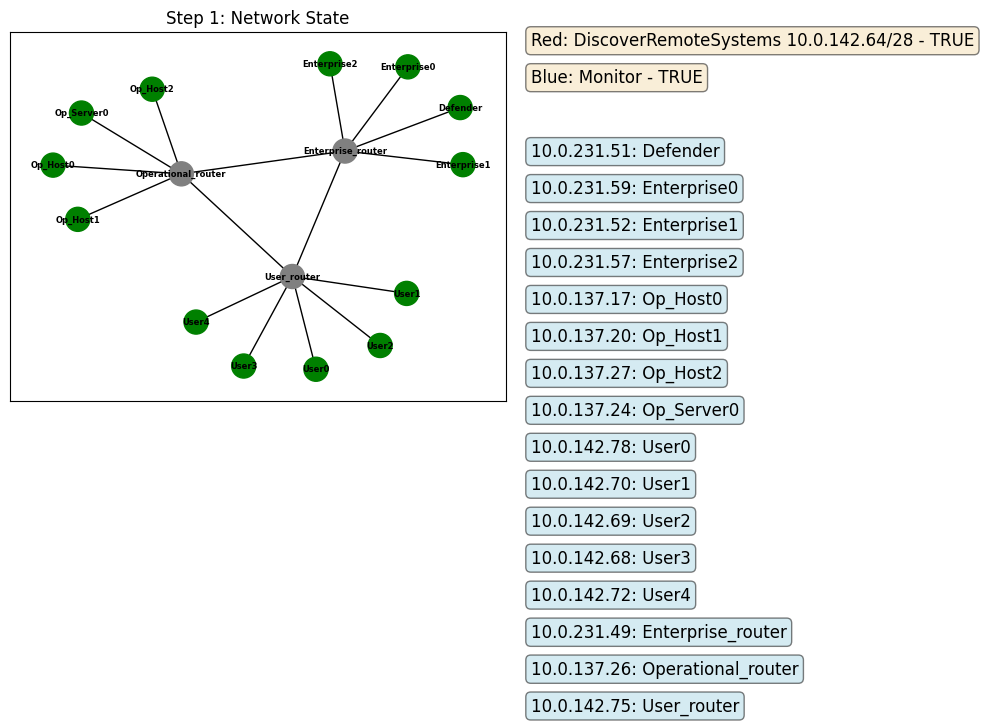

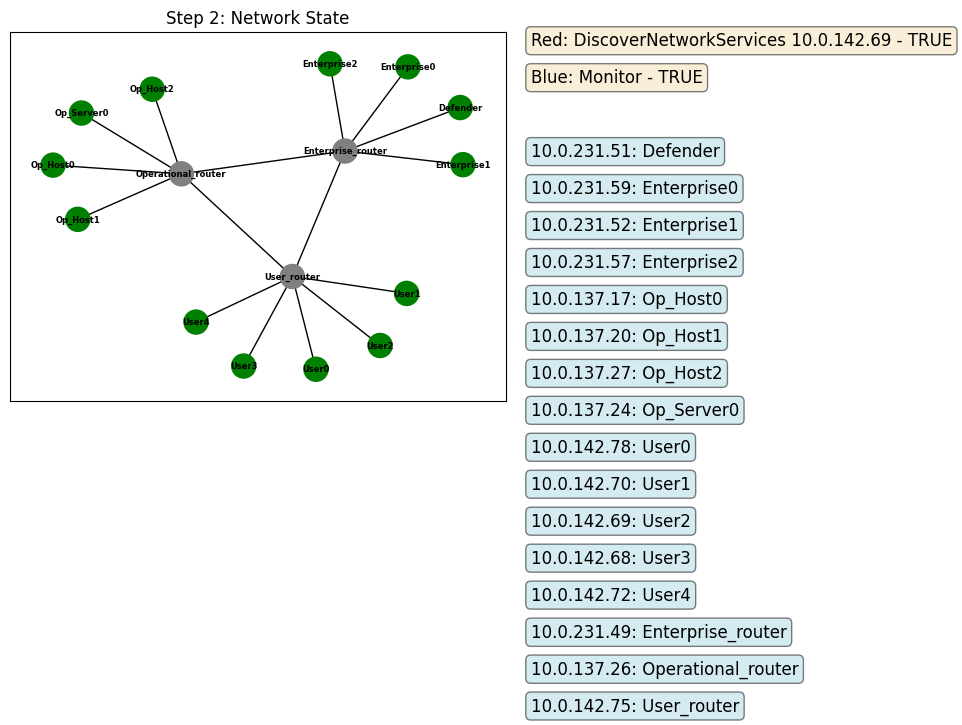

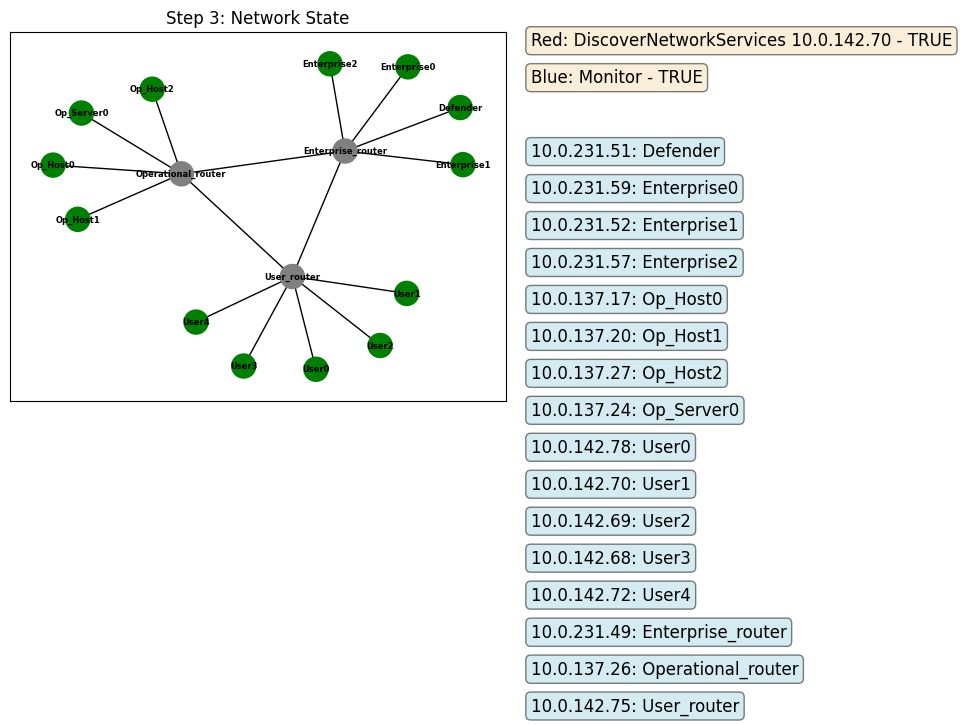

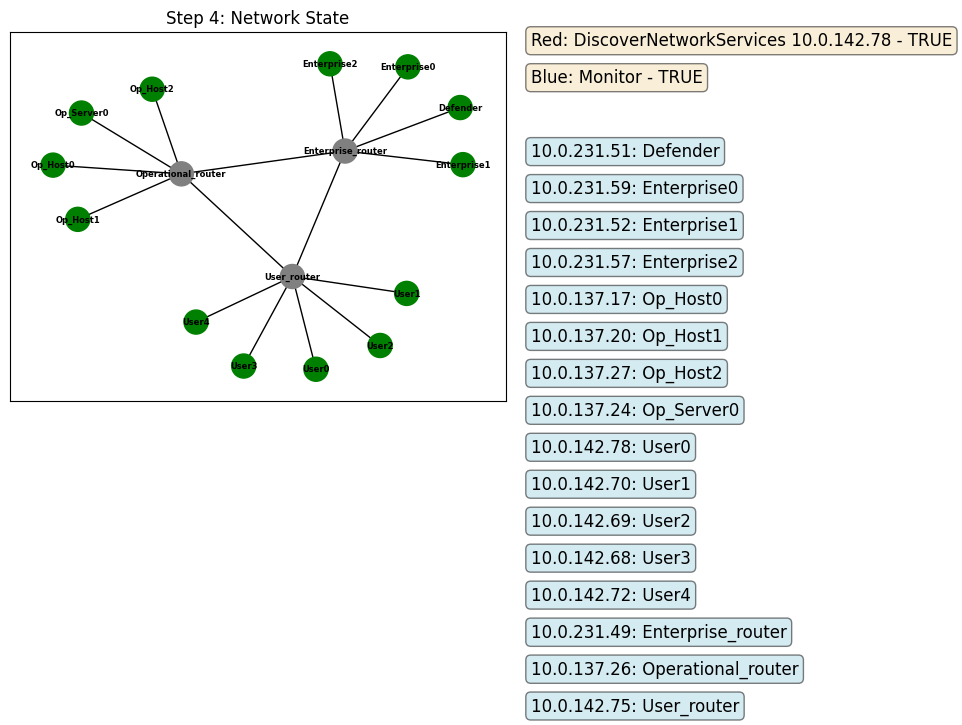

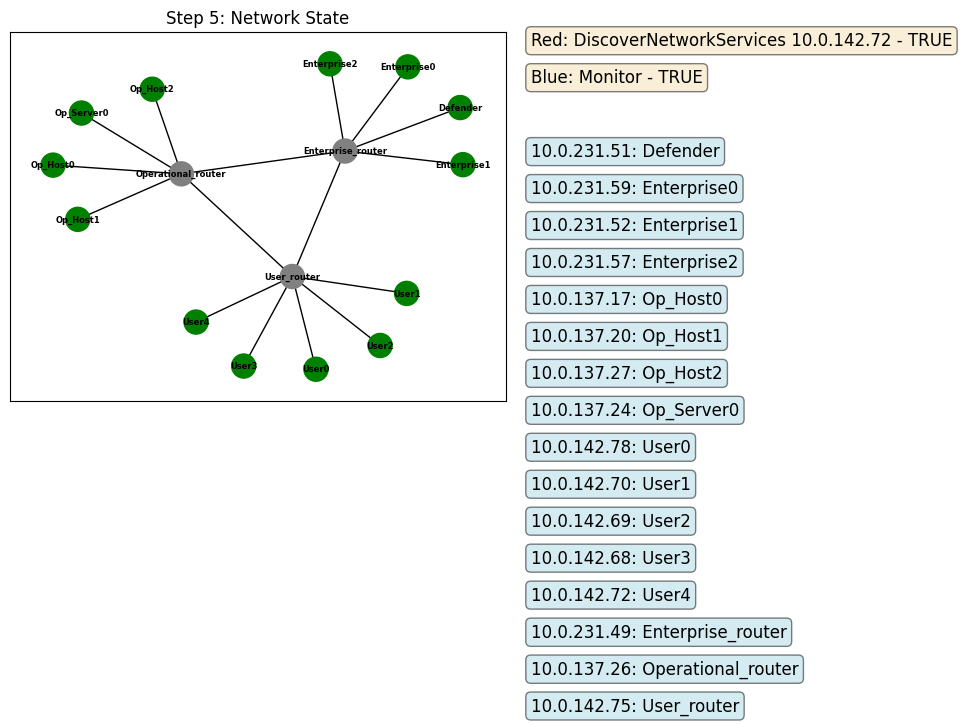

...

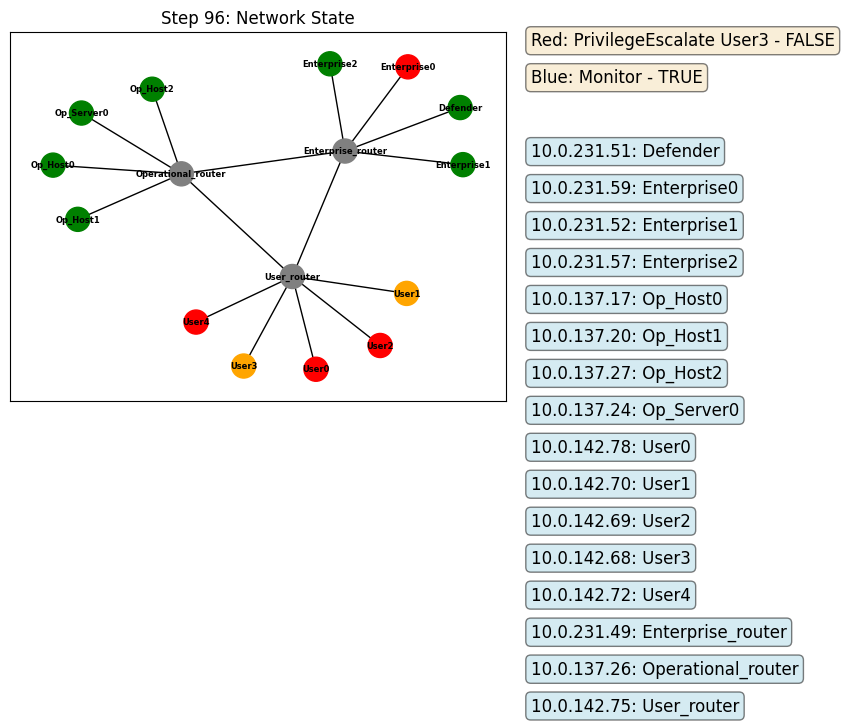

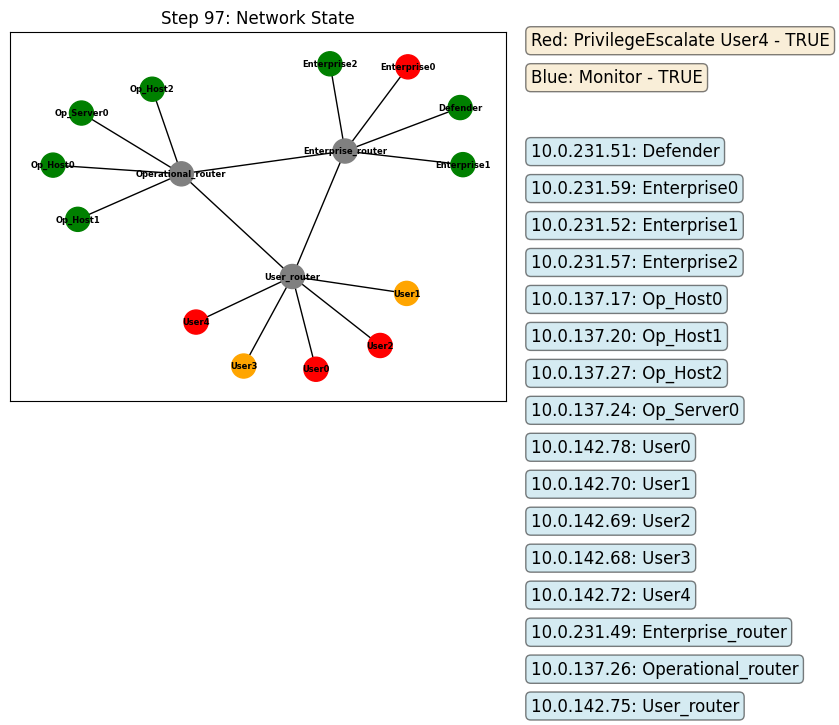

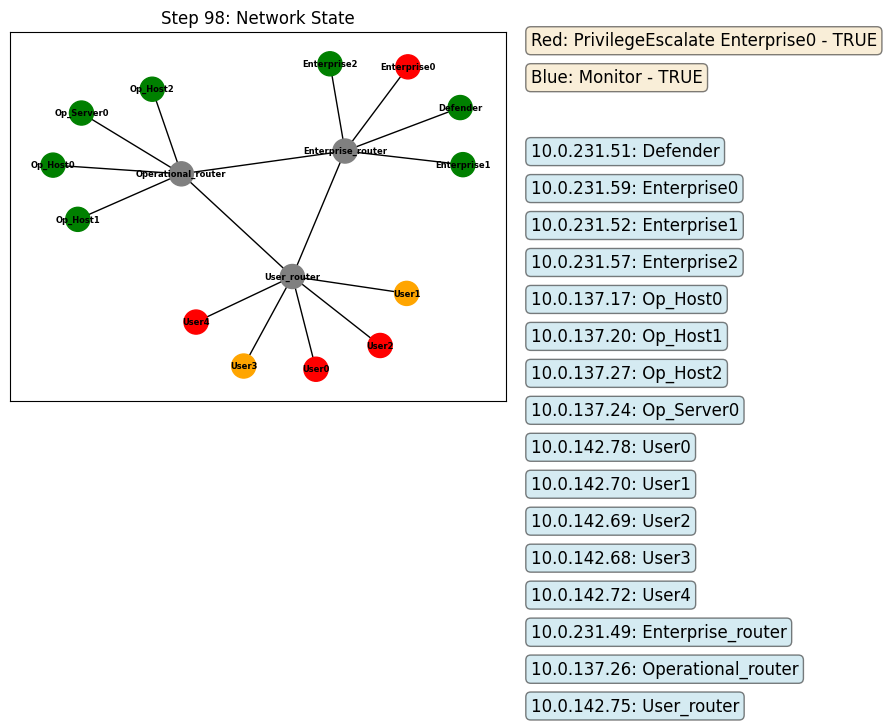

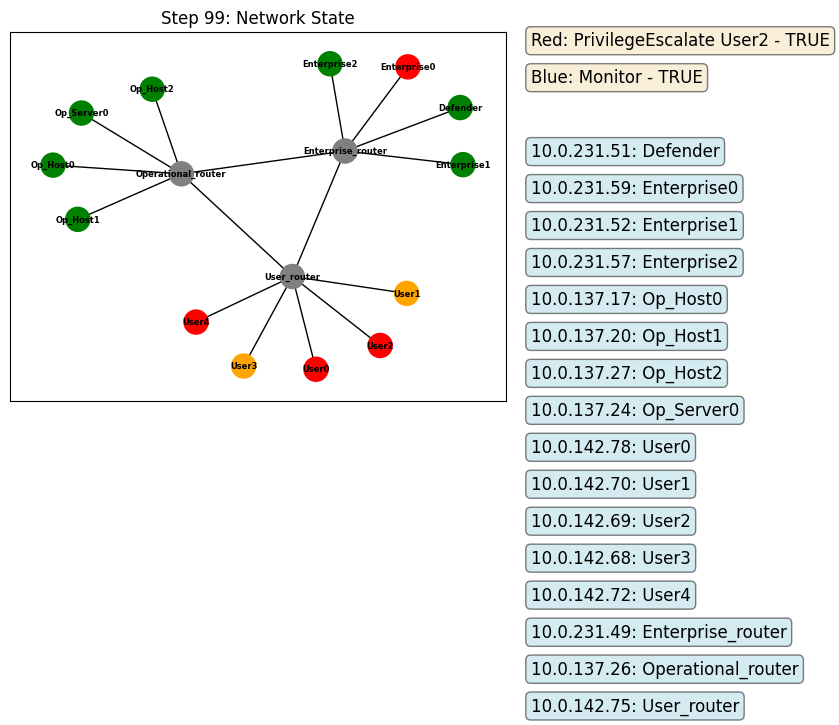

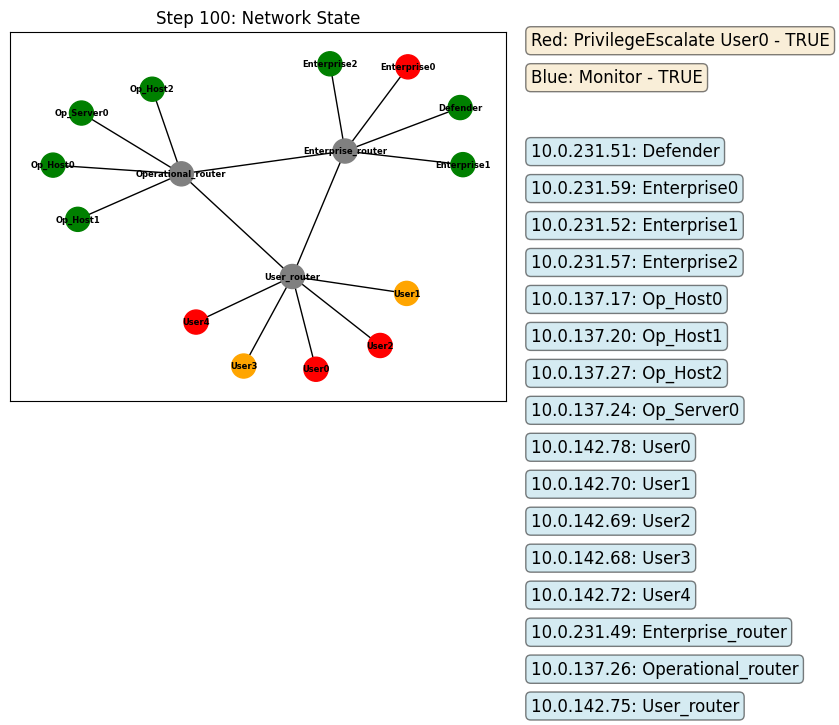

In [36]:
# render_game_with_matplotlib(game_states)

## Play trained Agent

## Training

### Q-Learning Agent

In [30]:
def run_training_example_q_learning(scenario):
    agent_name = 'Red'
    path = str(inspect.getfile(CybORG))
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/{scenario}.yaml'
    sg = FileReaderScenarioGenerator(path)
    cyborg = CybORG(scenario_generator=sg)
    cyborg = OpenAIGymWrapper(agent_name=agent_name,
                              env=FixedFlatWrapper(cyborg))

    observation = cyborg.reset()
    action_space = cyborg.action_space
    print(f"Observation size {len(observation)}, Action Size {action_space}")
    action_count = 0
    agent = RandomAgent()
    print(agent)
    agent.set_initial_values(action_space, observation)
    for i in range(MAX_EPS):  # laying multiple games
        print(f"\rTraining Game: {i}\n", end='', flush=True)
        reward = 0
        for j in range(MAX_STEPS_PER_GAME):  # step in 1 game
            action = agent.get_action(observation, action_space)
            next_observation, r, done, info = cyborg.step(action)

            action_space = cyborg.action_space
            reward += r

            agent.train(observation)  # training the agent
            observation = next_observation
            if done or j == MAX_STEPS_PER_GAME - 1:
                print(f"Training reward: {reward}")
                break
        agent.end_episode()
        observation = cyborg.reset()
        action_space = cyborg.action_space
        agent.set_initial_values(action_space, observation)

### Deep RL Algorithms Agent

- PPO

In [31]:
#!pip install -U "ray[all]"

In [32]:
# import inspect
# import numpy as np
# from CybORG import CybORG
# from CybORG.Agents import B_lineAgent, GreenAgent
# from CybORG.Agents.Wrappers import ChallengeWrapper

In [33]:
# from ray import tune

# tune.run(
#     "PPO",
#     config={
#         "env": "YourEnvName",
#         "num_gpus": 0,
#         "other_config_options": "...",
#     }
# )

In [34]:
# from ray.rllib.algorithms.ppo import PPOConfig

# config = (  # 1. Configure the algorithm,
#     PPOConfig()
#     .environment("Taxi-v3")
#     .rollouts(num_rollout_workers=2)
#     .framework("torch")
#     .training(model={"fcnet_hiddens": [64, 64]})
#     .evaluation(evaluation_num_workers=1)
# )

# algo = config.build()  # 2. build the algorithm,

# for _ in range(5):
#     print(algo.train())  # 3. train it,

# algo.evaluate()  # 4. and evaluate it.

In [35]:
# from ray.rllib.algorithms import ppo
# from ray.rllib.env import ParallelPettingZooEnv
# from ray.tune import register_env

In [36]:
# from CybORG.Agents.Wrappers.PettingZooParallelWrapper import PettingZooParallelWrapper
# from CybORG.Simulator.Scenarios import FileReaderScenarioGenerator, DroneSwarmScenarioGenerator

In [48]:
class RLLibWrapper(ChallengeWrapper):
    def init(self, agent_name, env, reward_threshold=None, max_steps=None):
        super().__init__(agent_name, env, reward_threshold, max_steps)

    def step(self, action=None):
        obs, reward, done, info = self.env.step(action=action)
        self.step_counter += 1
        if self.max_steps is not None and self.step_counter >= self.max_steps:
            done = True
        return np.float32(obs), reward, done, info

    def reset(self):
        self.step_counter = 0
        obs = self.env.reset()
        return np.float32(obs)

In [ ]:
def env_creator_CC1(env_config: dict):
    path = str(inspect.getfile(CybORG))
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario1b.yaml'
    sg = FileReaderScenarioGenerator(path)
    agents = {"Red": B_lineAgent(), "Green": GreenAgent()}
    cyborg = CybORG(scenario_generator=sg, environment='sim', agents=agents)
    env = RLLibWrapper(env=cyborg, agent_name="Blue", max_steps=100)
    return env

In [ ]:
def env_creator_CC2(env_config: dict):
    path = str(inspect.getfile(CybORG))
    path = path[:-7] + f'/Simulator/Scenarios/scenario_files/Scenario2.yaml'
    sg = FileReaderScenarioGenerator(path)
    agents = {"Red": B_lineAgent(), "Green": GreenAgent()}
    cyborg = CybORG(scenario_generator=sg, environment='sim', agents=agents)
    env = RLLibWrapper(env=cyborg, agent_name="Blue", max_steps=100)
    return env

In [ ]:
def env_creator_CC3(env_config: dict):
    sg = DroneSwarmScenarioGenerator()
    cyborg = CybORG(scenario_generator=sg, environment='sim')
    env = ParallelPettingZooEnv(PettingZooParallelWrapper(env=cyborg))
    return env

In [ ]:
def print_results(results_dict):
    train_iter = results_dict["training_iteration"]
    r_mean = results_dict["episode_reward_mean"]
    r_max = results_dict["episode_reward_max"]
    r_min = results_dict["episode_reward_min"]
    print(f"{train_iter:4d} \tr_mean: {r_mean:.1f} \tr_max: {r_max:.1f} \tr_min: {r_min: .1f}")

In [ ]:
# if __name__ == "__main__":
#     register_env(name="CC1", env_creator=env_creator_CC1)
#     register_env(name="CC2", env_creator=env_creator_CC2)
#     register_env(name="CC3", env_creator=env_creator_CC3)
#     config = ppo.DEFAULT_CONFIG.copy()
#     for env in ['CC1', 'CC2', 'CC3']:
#         agent = ppo.PPOTrainer(config=config, env=env)

#         train_steps = 1e2
#         total_steps = 0
#         while total_steps < train_steps:
#             results = agent.train()
#             print_results(results)
#             total_steps = results["timesteps_total"]